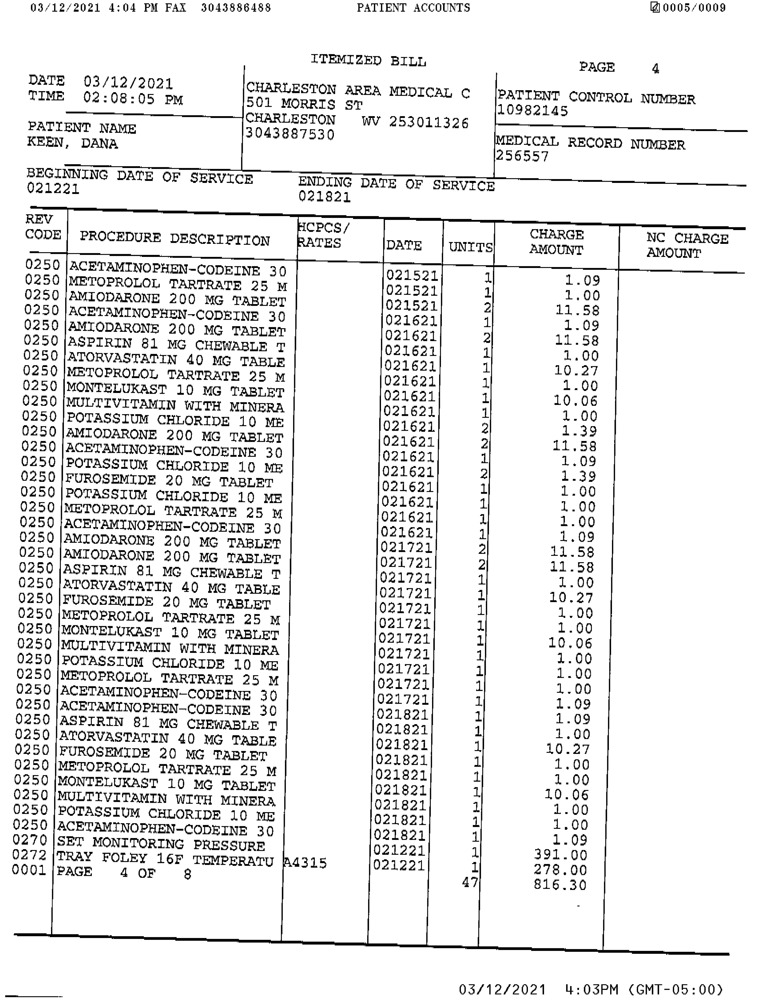

In [4]:
import numpy as np
from cv2 import cv2
from matplotlib import pyplot as plt
# f="/n01/data/nlp_aeac/mostofa_env/INPUT/IMAGES/CAMC_IB_Nancy Nunn_Claim # 21858131287.pdf/CAMC_IB_Nancy Nunn_Claim # 21858131287_11.jpg"
# f = "/n01/data/nlp_aeac/mostofa_env/INPUT/IMAGES/CAMC_IB_Clint Ellithorp_Claim # 21358265595.pdf/CAMC_IB_Clint Ellithorp_Claim # 21358265595_4.jpg"

f = "/n01/data/nlp_aeac/mostofa_env/INPUT/IMAGES/CAMC_IB_Dana Keen_Claim # 21755930880.pdf/CAMC_IB_Dana Keen_Claim # 21755930880_4.jpg"


def display(im_path):
    dpi = 100
    im_data = plt.imread(im_path)

    height, width  = im_data.shape[:2]
    
    # What size does the figure need to be in inches to fit the image?
    figsize = width / float(dpi), height / float(dpi)

    # Create a figure of the right size with one axes that takes up the full figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0, 0, 1, 1])

    # Hide spines, ticks, etc.
    ax.axis('off')

    # Display the image.
    ax.imshow(im_data, cmap='gray')

    plt.show()

image = cv2.imread(f)
# image = cv2.resize(image,(800,600))
image_gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
# cv2.imshow('binary_1.jpg', image_gray)
cv2.imwrite("temp/binary_1.jpg", image_gray)
display('temp/binary_1.jpg')




/n01/data/nlp_aeac/mostofa_env/mo_venv/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: invalid value encountered in double_scalars
  
/n01/data/nlp_aeac/mostofa_env/mo_venv/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in double_scalars
  # Remove the CWD from sys.path while we load stuff.


87


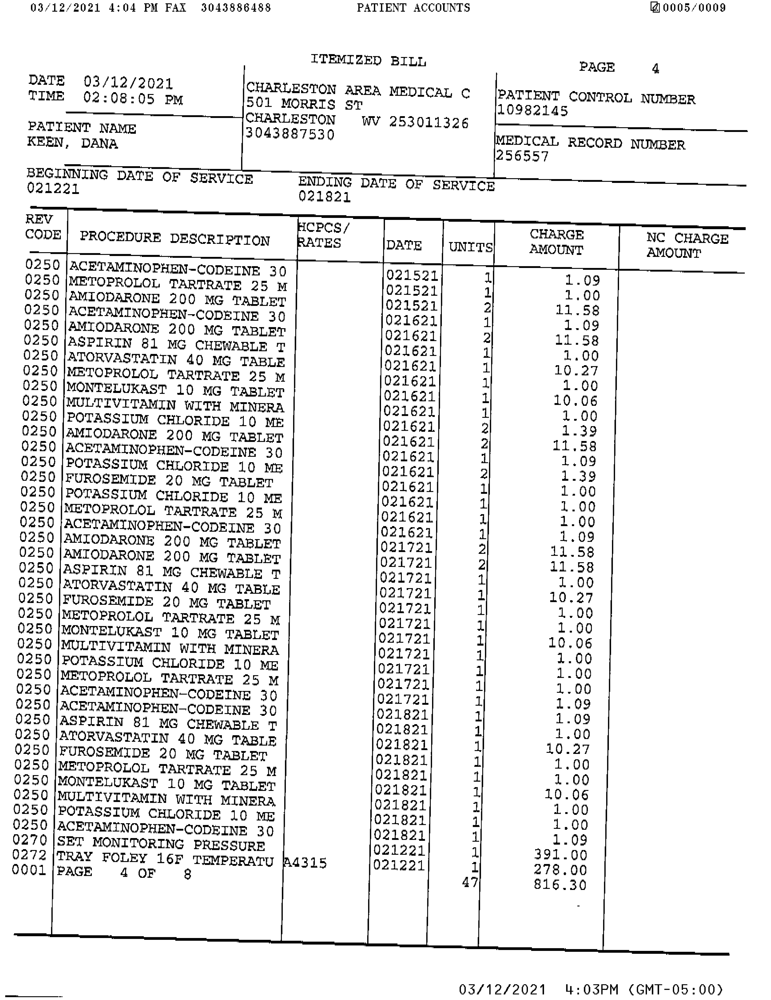

In [5]:
hist = cv2.calcHist([image_gray],[0],None,[255],[0,255])
# print(hist)
within = []
for i in range(len(hist)):
    x,y = np.split(hist,[i])
    x1 = np.sum(x)/(image_gray.shape[0]*image_gray.shape[1])
    y1 = np.sum(y)/(image_gray.shape[0]*image_gray.shape[1])
    x2 = np.sum([ j*t for j,t in enumerate(x)])/np.sum(x)
    y2 = np.sum([ j*t for j,t in enumerate(y)])/np.sum(y)
    x3 = np.sum([ (j-x2)**2*t for j,t in enumerate(x)])/np.sum(x)
    x3 = np.nan_to_num(x3)
    y3 = np.sum([ (j-y2)**2*t for j,t in enumerate(y)])/np.sum(y)
    y3 = np.nan_to_num(y3)
    within.append(x1*x3 + y1*y3)
m = np.argmin(within)
print(m)
(thresh, Bin) = cv2.threshold(image_gray,m,255,cv2.THRESH_BINARY)
# cv2.imshow("Binary_OTSU", Bin)
cv2.imwrite("temp/binary_otsu.jpg", Bin)
display('temp/binary_otsu.jpg')

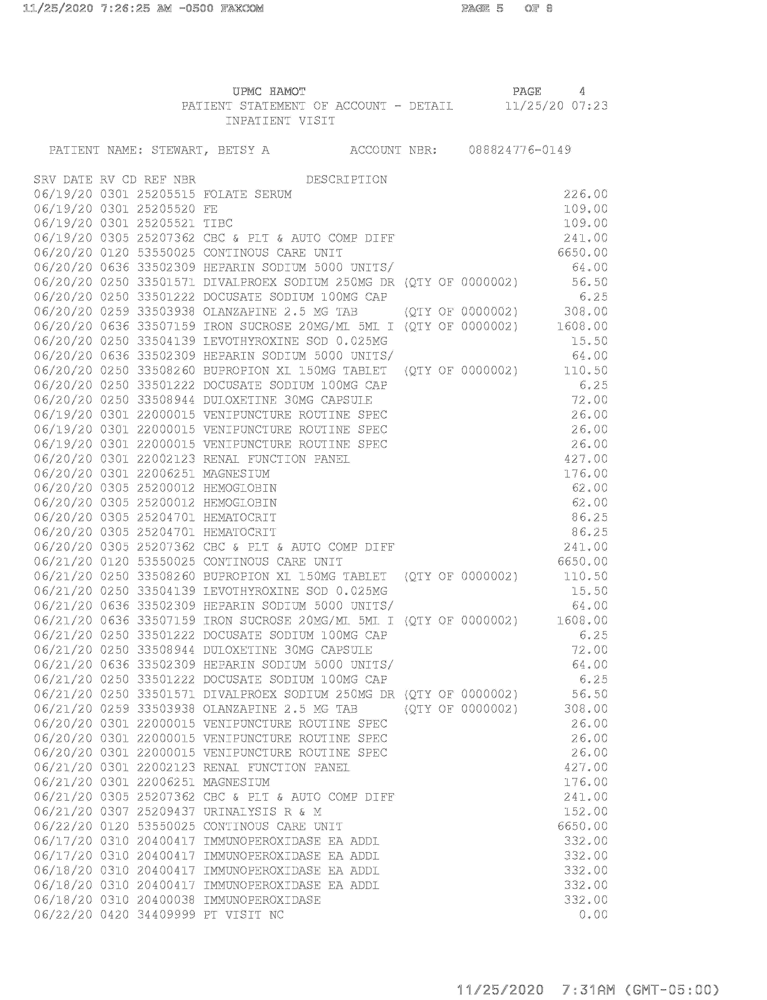

In [25]:
adp_thresholding = cv2.adaptiveThreshold(image_gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 3, 5)
cv2.imwrite("temp/binary_adap.jpg", adp_thresholding)
display('temp/binary_adap.jpg')

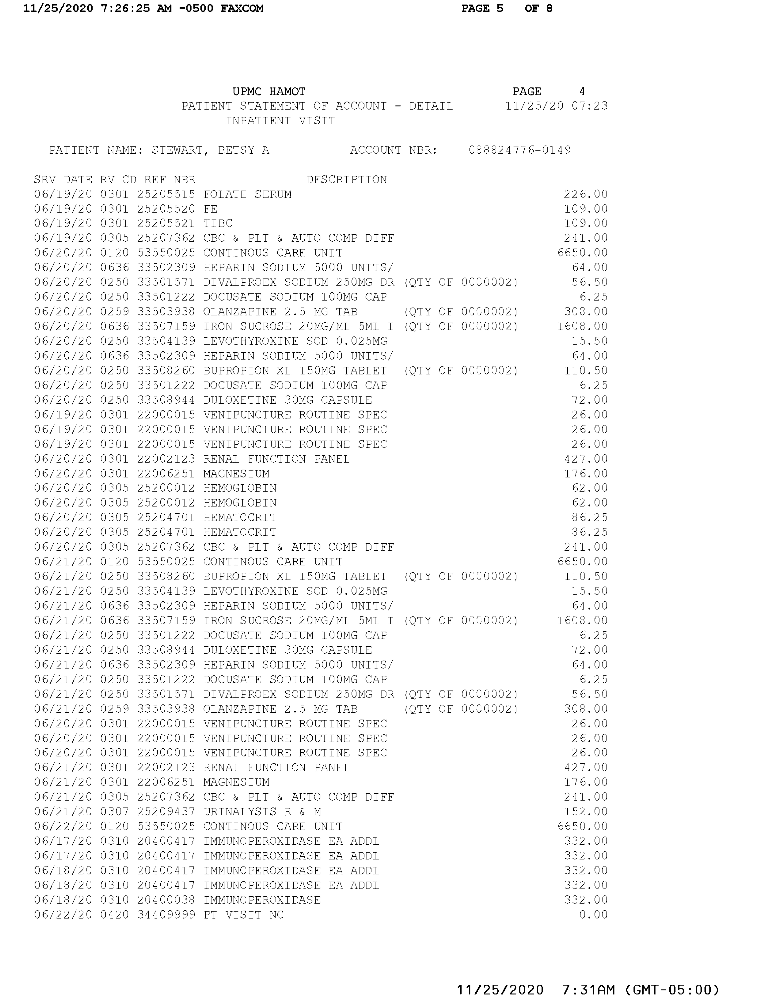

In [28]:
ret, threshold_1 = cv2.threshold(image_gray, 127, 255, cv2.THRESH_BINARY)
cv2.imwrite("temp/binary_bi_thresh.jpg", threshold_1)
display('temp/binary_bi_thresh.jpg')

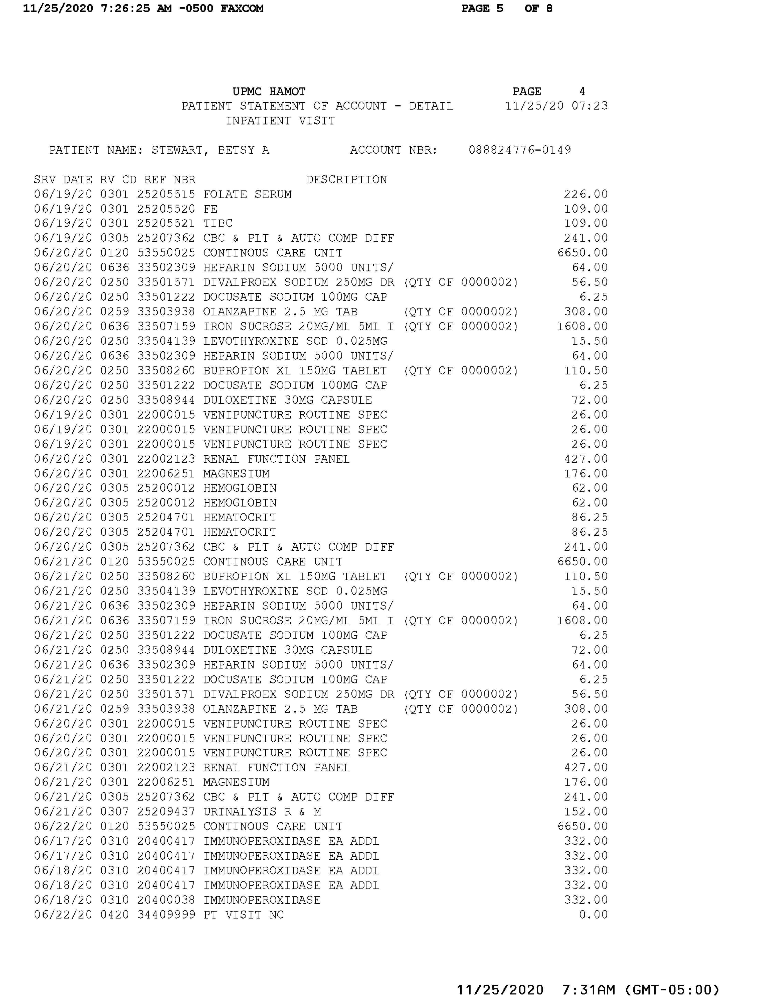

In [64]:
ret, cv_otsu_binary = cv2.threshold(image_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
cv2.imwrite("temp/binary_cv_otsu_binary.jpg", cv_otsu_binary)
display('temp/binary_cv_otsu_binary.jpg')

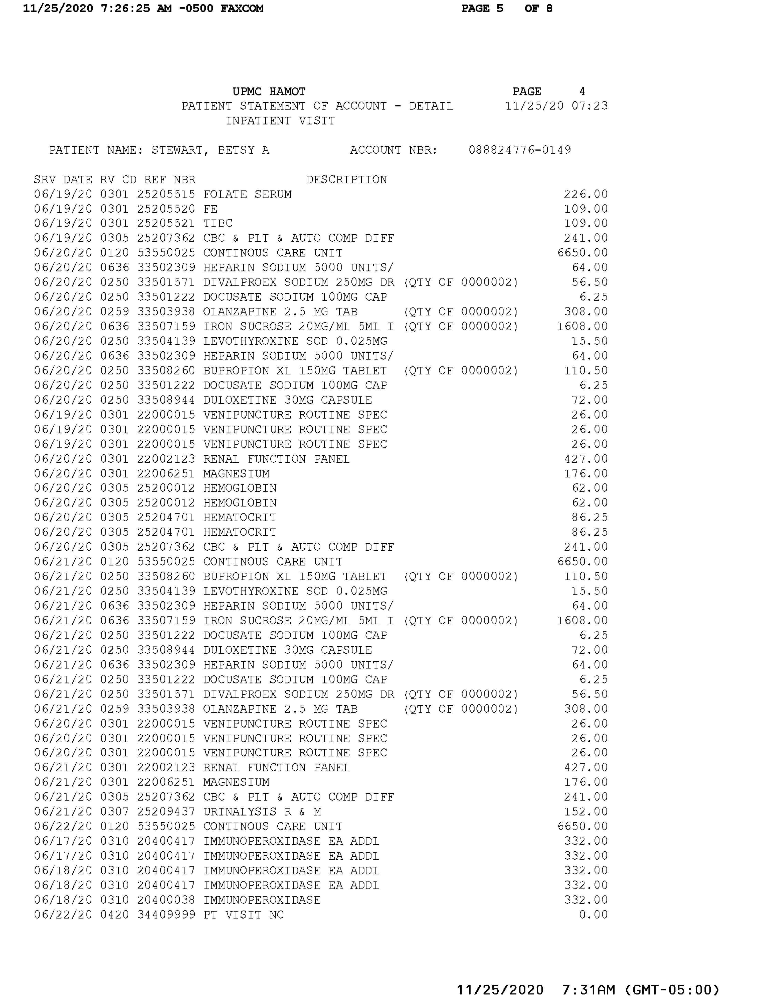

In [30]:
ret, m_cv_otsu_binary = cv2.threshold(image_gray, m, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
cv2.imwrite("temp/binary_m_cv_otsu_binary.jpg", m_cv_otsu_binary)
display('temp/binary_m_cv_otsu_binary.jpg')

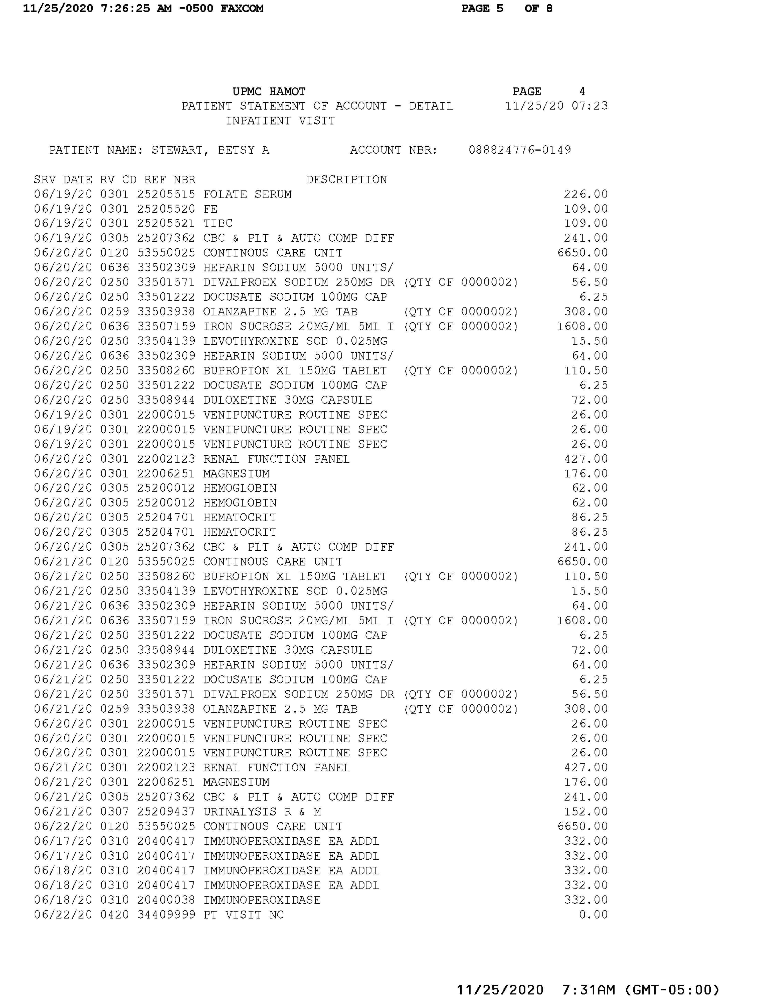

In [65]:
# th2 = cv2.adaptiveThreshold(image_gray,255,cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,11,2)
# th2 = cv2.adaptiveThreshold(image_gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 3, 5)
# th2 = cv2.adaptiveThreshold(image_gray,255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY,11,2)

# kernel_erosion = np.ones((3,3), np.uint8)
kernel_dilation = np.ones((1,1), np.uint8)
# erosion = cv2.erode(th2, kernel_erosion, iterations=1)
# dilation = cv2.dilate(erosion, kernel_dilation, iterations=1)
dilation = cv2.dilate(cv_otsu_binary, kernel_dilation, iterations=1)
cv2.imwrite("temp/binary_er_di.jpg", dilation)
display('temp/binary_er_di.jpg')